## Optimization Project

In [1]:
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline
from matplotlib import rcParams
rcParams['figure.figsize'] = 9.7,6.27
from sklearn.metrics import r2_score
import pandas as pd

In [1117]:
class Optimizer:
    def __init__(self,alpha,max_iters,grad_check,cost_check,
               batch_size,Optimizing_method,gamma=None,initial_values=None):
        """
        Initializes an instance of the Optimizer class.
        
        Args:
            alpha (float): Learning rate for gradient descent.
            max_iters (int): Maximum number of iterations for optimization.
            grad_check (float): Threshold for gradient norm to determine convergence.
            cost_check (float): Threshold for cost function difference to determine convergence.
            batch_size (int): Size of mini-batch for mini-batch gradient descent.
            Optimizing_method (str): Optimization method to use ('GD' for gradient descent or 'Momentum' for momentum gradient descent).
            gamma (float, optional): Momentum factor for momentum gradient descent. Defaults to None.
            initial_values (numpy.ndarray, optional): Initial values for model parameters. Defaults to None.
        
        Raises:
            Exception: If an incorrect optimization method is provided.
        """
        
        self.alpha = alpha
        self.max_iters = max_iters
        self.grad_check = grad_check
        self.cost_check = cost_check
        self.initial_values = np.array(initial_values).reshape(1,-1)
        self.batch_size = batch_size
        self.loss = []
        self.loss_epoch = []
        self.thetas = []
        self.predictions = []
        self.theta_opt = []
        self.gamma = gamma
        self.y = None
        if Optimizing_method not in ['GD','Momentum']:
            raise Exception("Sorry, you entered an incorrect optimization method \n Please enter 'GD' or 'Momentum'")
        else:
            self.opt_method = Optimizing_method
        

    def Gradient(self,X,y,alpha,max_iters,batch_size,grad_check,cost_check):
        self.y = y
        if (self.initial_values == None).all():
            X, theta = self.theta_initialize(X)
        else:
            X = np.hstack((np.ones((len(X),1)),X))
            theta = self.initial_values
        y=y.reshape(-1,1)
        loss_batch = []
        loss_epoch = []
        
        num_batch = len(X) // batch_size
        x_batches = []
        y_batches = []
        for i in range(num_batch):
            mini_x = X[i * batch_size: (i + 1) * batch_size]
            mini_y = y[i * batch_size: (i + 1) * batch_size]
            x_batches.append(mini_x)
            y_batches.append(mini_y)
        
        if len(X) % batch_size != 0:
            mini_x = X[num_batch * batch_size:]
            mini_y = y[num_batch * batch_size:]
            x_batches.append(mini_x)
            y_batches.append(mini_y)

            
        for i in range(max_iters):
            for j in range(len(x_batches)):
                self.thetas.append(theta)
                x_b = x_batches[j]
                y_b = y_batches[j]
                y_predict = np.matmul(x_b,theta.T)
                error = (y_predict-y_b)
                MSE = (error**2).mean()/2
                self.loss.append(MSE)
                d_theta = ((y_predict - y_b)*x_b).mean(axis=0, keepdims=True)
                theta = theta - alpha*d_theta
            self.loss_epoch.append(MSE)
            if i>=1:
                if np.linalg.norm(d_theta) < grad_check or np.abs(self.loss_epoch[-2] - self.loss_epoch[-1]) < cost_check:
                    print('*************************** CONVERGED ************************')
                    print('Converged at Epoch {} \n'.format(i))
                    print('Gradient Vector: \n {}'.format(d_theta))
                    print('Vector Norm: {} \n'.format(np.linalg.norm(d_theta)))
                    print('Theta Optimum: \n {}'.format(theta))
                    print('j = {} \n'.format(MSE))
                    break
                else:
                    print('*************************** Epoch {} ************************'.format(i))
                    print('Gradient Vector: \n {}'.format(d_theta))
                    print('Vector Norm: {} \n'.format(np.linalg.norm(d_theta)))
                    print('Theta: \n {}'.format(theta))
                    print('j = {} \n'.format(self.loss_epoch[i]))
        return theta, np.matmul(X,theta.T),self.loss

    
    def momentum_GD(self,X,y,alpha,max_iters,batch_size,grad_check,cost_check,gamma):
        self.y = y
        if (self.initial_values == None).all():
            X, theta = self.theta_initialize(X)
        else:
            X = np.hstack((np.ones((len(X),1)),X))
            theta = self.initial_values
        y = y.reshape(-1, 1)
        loss = []
        thetas = []
        vt = 0
        
        num_batch = len(X) // batch_size
        x_batches = []
        y_batches = []
        for i in range(num_batch):
            mini_x = X[i * batch_size: (i + 1) * batch_size]
            mini_y = y[i * batch_size: (i + 1) * batch_size]
            x_batches.append(mini_x)
            y_batches.append(mini_y)
        
        if len(X) % batch_size != 0:
            mini_x = X[num_batch * batch_size:]
            mini_y = y[num_batch * batch_size:]
            x_batches.append(mini_x)
            y_batches.append(mini_y)
            
        for i in range(max_iters):
            c = 0
            for X_batch, y_batch in zip(x_batches, y_batches):
                c += 1
                self.thetas.append(theta)
                print('*********************** Iteration {} ******************'.format(c)) 
                y_predict = np.matmul(X_batch, theta.T)
                print('h(x):{} \n'.format(y_predict.T))
                error = (y_predict - y_batch)
                print('Error Vector: \n {}'.format(error.T))
                MSE = (error**2).mean()/2
                self.loss.append(MSE)
                print('j = {}'.format(MSE))
                d_theta = ((y_predict - y_batch) * X_batch).mean(axis=0, keepdims=True)
                vt = gamma * vt + alpha * d_theta
                print('Gradient Vector: \n {}'.format(d_theta.T))
                print('Vector Norm: {} \n'.format(np.linalg.norm(d_theta)))
            self.loss_epoch.append(MSE)
            if i > 2:
                if np.linalg.norm(d_theta) < grad_check or np.abs(self.loss_epoch[-2] - self.loss_epoch[-1]) < cost_check:
                    print('*************************** CONVERGED ************************')
                    print('Converged at Iteration {} \n'.format(i))
                    print('Error Vector: \n {} \n'.format(error))
                    print('j = {} \n'.format(MSE))
                    print('h(x):{} \n'.format(y_predict))
                    print('y_actual: \n {} \n'.format(y_batch))
                    break
            theta = theta - vt
            print('theta_new : {} \n'.format(theta))
        thetas = thetas[1:]
        print("Theta Optimum is {}".format(theta))
        print(np.matmul(X,theta.T).shape)
        return theta, np.matmul(X,theta.T), self.loss


    def theta_initialize(self,X):
        X = np.hstack((np.ones((len(X),1)),X))
        theta = np.array([[0]*(X.shape[-1])])
        return X,theta
        
    def train(self,X,y):
        if self.opt_method == 'GD':
            self.theta_opt, self.predictions,self.loss = self.Gradient(X,y,self.alpha,self.max_iters,self.batch_size,self.grad_check,self.cost_check)
        elif self.opt_method == 'Momentum':
            self.theta_opt, self.predictions,self.loss = self.momentum_GD(X,y,self.alpha,self.max_iters,self.batch_size,self.grad_check,self.cost_check,self.gamma)
    
    
    def plot_loss_iters(self):
        plt.plot(range(0,len(self.loss)),self.loss,marker='o',color='red')
        plt.title('Iterations vs Loss')
        
    def plot_loss_thetas(self):
        theta_plot = np.concatenate(self.thetas, axis=0)
        for i in range(theta_plot.shape[1]):
            plt.figure()
            plt.plot(theta_plot[:,i],self.loss,marker='o',color='red')
            plt.title('Theta_{} vs Loss'.format(i));
            plt.show

    
    def get_accuracy(self):
        return r2_score(self.y,self.predictions)

    def get_theta_opt(self):
        return self.theta_opt

    def get_predictions(self):
        return self.predictions

    def get_loss(self):
        return self.loss

    def get_thetas(self):
        return self.thetas

#### To define an instance of the class: 
- Optimizer (Learning Rate, Maximum Number of Iterations, Gradient Convergence Check, Cost Convergence Check, Optimizing Method (Momentum or Gradient), Gamma (Default=None), Initial Values for parameters (Default=None))

#### Data Generation using Sklearn

In [952]:
from sklearn.datasets import make_regression
X, y = make_regression(n_samples=1000, n_features=4, noise=10, random_state=42)
y=y.reshape(-1,1)

#### Scenario 1: 
##### Gradient Descent with batch size 1, No of Iters = 300, learning rate = 0.0005, Cost Convergence Check and Cost Convergence Check = 0.001

In [378]:
GD1 = Optimizer(0.0005,300,0.0001,0.0001,1,'GD')

In [379]:
GD1.train(X,y)

*************************** Epoch 1 ************************
Gradient Vector: 
 [[-33.46792347  39.42658159 -15.10157445 -39.60907547 -30.13447105]]
Vector Norm: 73.34562013568787 

Theta: 
 [[ 0.66592304 33.67299013  4.47411582 61.64322999 27.59020751]]
j = 560.0509506411406 

*************************** Epoch 2 ************************
Gradient Vector: 
 [[-18.54770069  21.84994941  -8.36919217 -21.95108631 -16.70032352]]
Vector Norm: 40.647655083029214 

Theta: 
 [[ 0.52994787 41.0123163   5.77022277 75.64349623 34.82292908]]
j = 172.0086005154635 

*************************** Epoch 3 ************************
Gradient Vector: 
 [[ -9.12629555  10.75114913  -4.11801562 -10.80091299  -8.21730363]]
Vector Norm: 20.000458270005062 

Theta: 
 [[ 0.33311006 45.33429285  6.65562214 84.10639991 39.5672458 ]]
j = 41.64463523992105 

*************************** Epoch 4 ************************
Gradient Vector: 
 [[-3.18046337  3.74671582 -1.4351056  -3.76405825 -2.86368473]]
Vector Norm: 6.97

In [380]:
GD1.get_accuracy()

0.9931738369664117

In [381]:
GD1.get_theta_opt()

array([[-0.47206052, 51.5557045 ,  8.39821676, 97.1441294 , 48.41430099]])

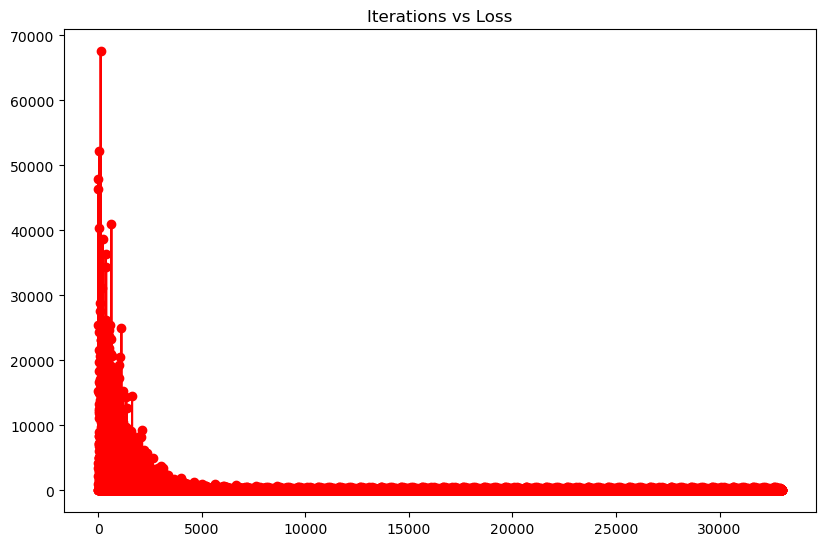

In [382]:
GD1.plot_loss_iters()

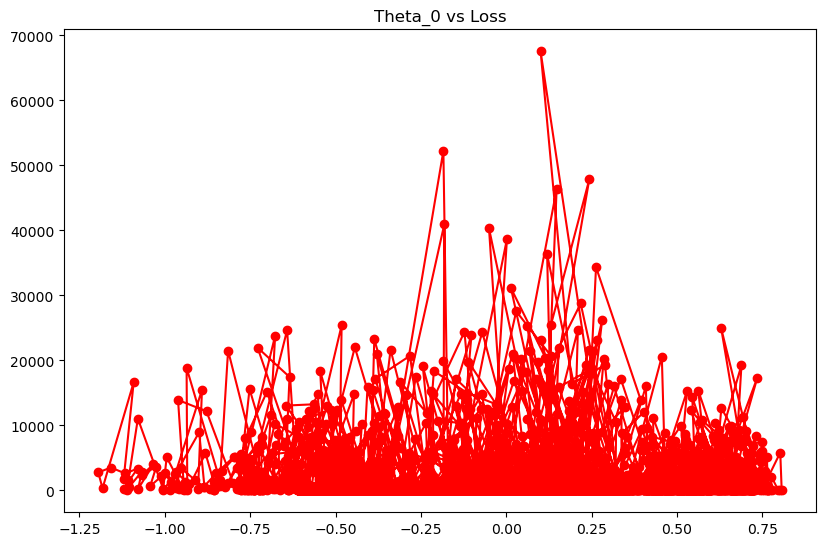

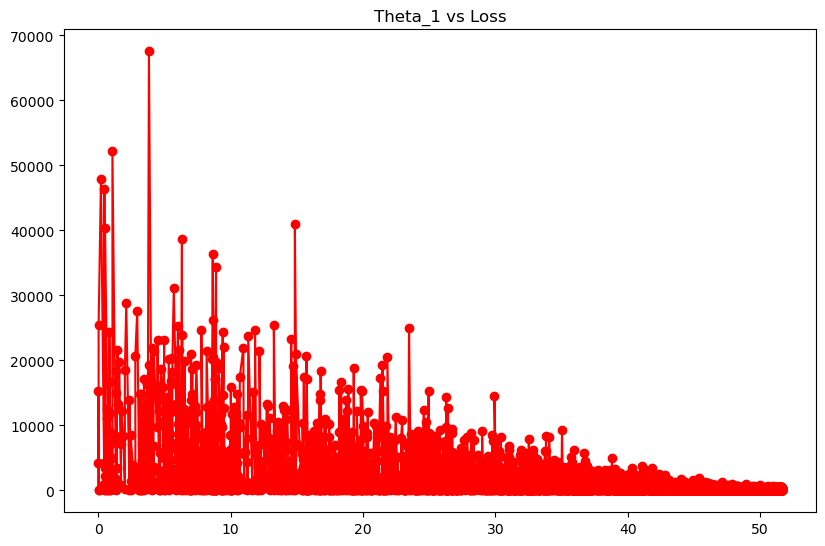

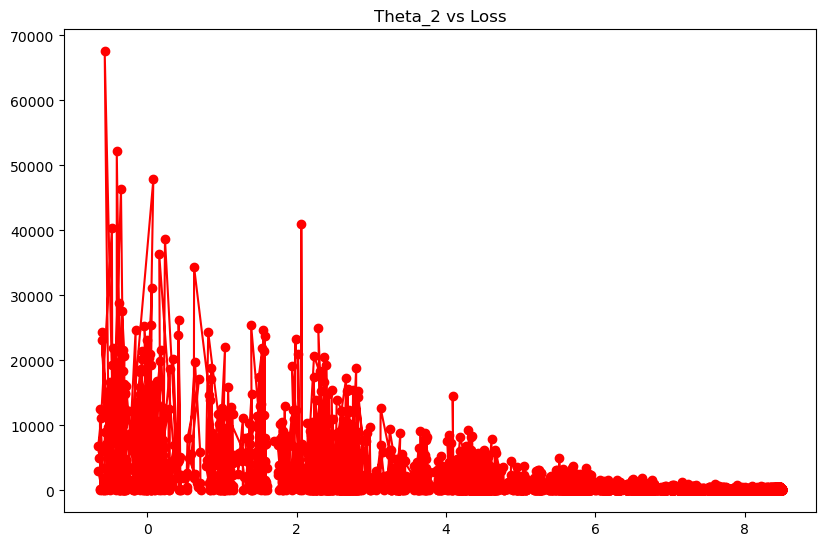

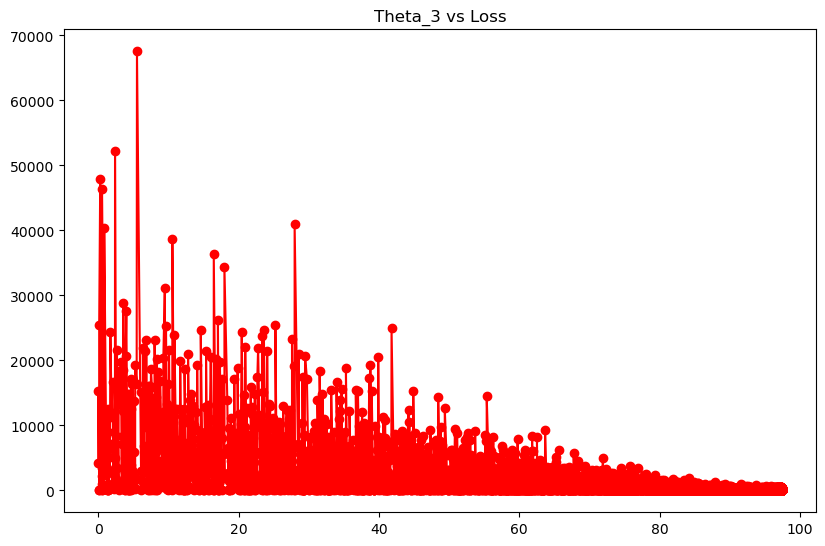

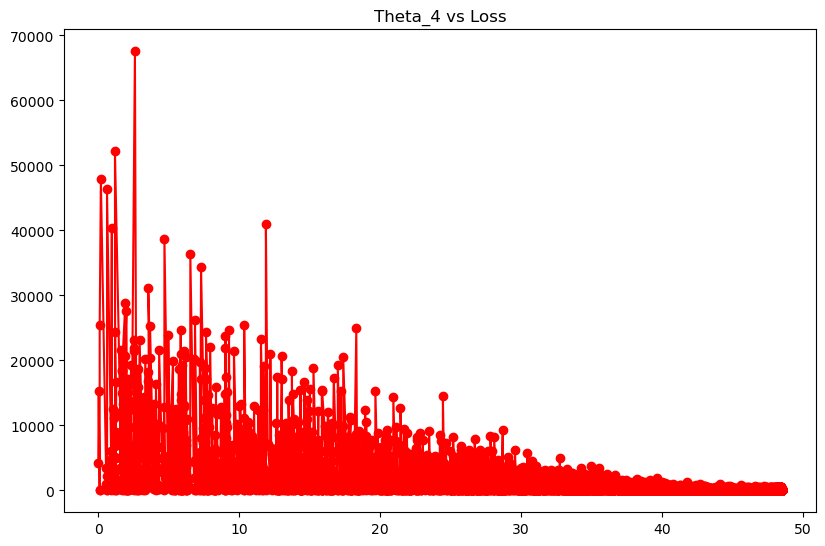

In [383]:
GD1.plot_loss_thetas()

#### Scenario 2: 
##### Gradient Descent with batch size 10, No of Iters = 5000, learning rate = 0.0001, Cost Convergence Check and Cost Convergence Check = 0.0001

In [953]:
Data = np.append(X,y,axis=1)
np.random.seed(42)
np.random.shuffle(Data)
X_s = Data[:, :4]
y_s = Data[:,1].reshape(-1,1)

In [1056]:
GD2 = Optimizer(0.0001,5000,0.0001,0.0001,10,'GD')

In [1057]:
GD2.train(X,y)

*************************** Epoch 1 ************************
Gradient Vector: 
 [[ -5.44799362 -44.38883219  40.90862507 -80.47579161 -20.95699192]]
Vector Norm: 102.90341689195283 

Theta: 
 [[0.03791424 1.07940759 0.12126223 1.94020715 0.80037487]]
j = 5185.008282733711 

*************************** Epoch 2 ************************
Gradient Vector: 
 [[ -5.39486141 -43.93135216  40.48568994 -79.63626444 -20.75965633]]
Vector Norm: 101.83838798178601 

Theta: 
 [[0.05626293 1.61058482 0.18134221 2.89567577 1.19570825]]
j = 5079.1491382450895 

*************************** Epoch 3 ************************
Gradient Vector: 
 [[ -5.34211822 -43.47862704  40.06709607 -78.80533919 -20.56396972]]
Vector Norm: 100.78422375789219 

Theta: 
 [[0.074214   2.13615772 0.24105639 3.84151927 1.58783929]]
j = 4975.4443833741325 

*************************** Epoch 4 ************************
Gradient Vector: 
 [[ -5.28976162 -43.03060722  39.65279859 -77.98292735 -20.3699186 ]]
Vector Norm: 99.74081268

In [1058]:
GD2.get_accuracy()

0.9931745693600179

In [1059]:
GD2.get_theta_opt()

array([[-0.50470295, 51.53266168,  8.43104672, 97.22686684, 48.43511313]])

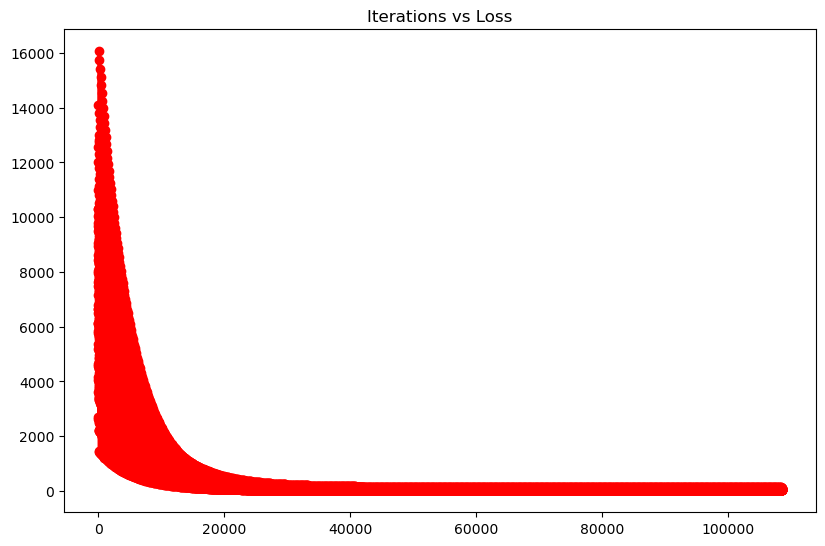

In [1060]:
GD2.plot_loss_iters()

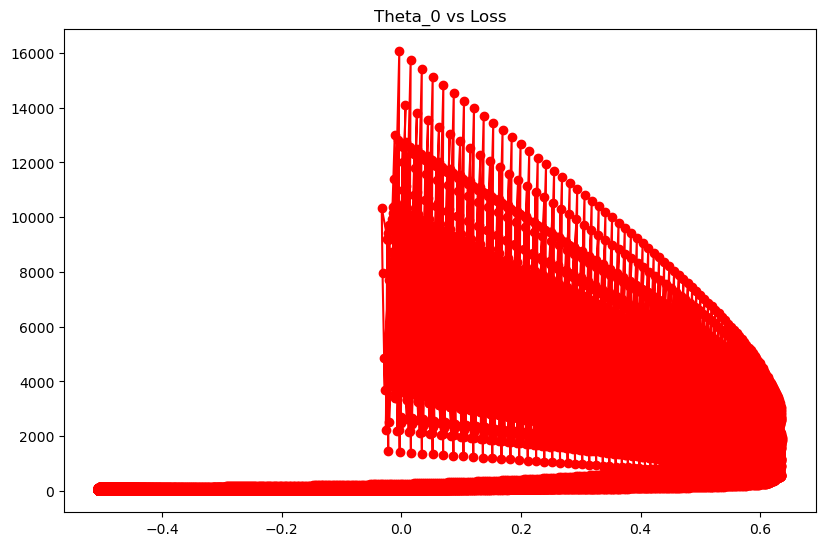

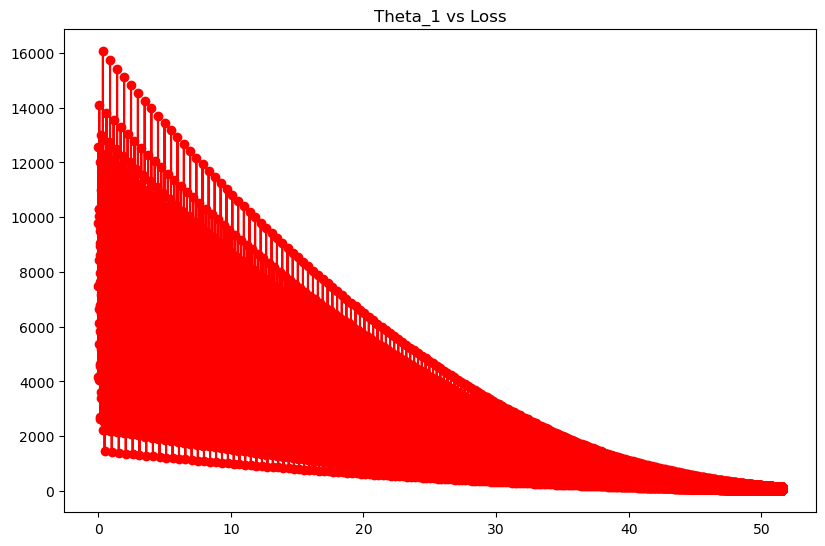

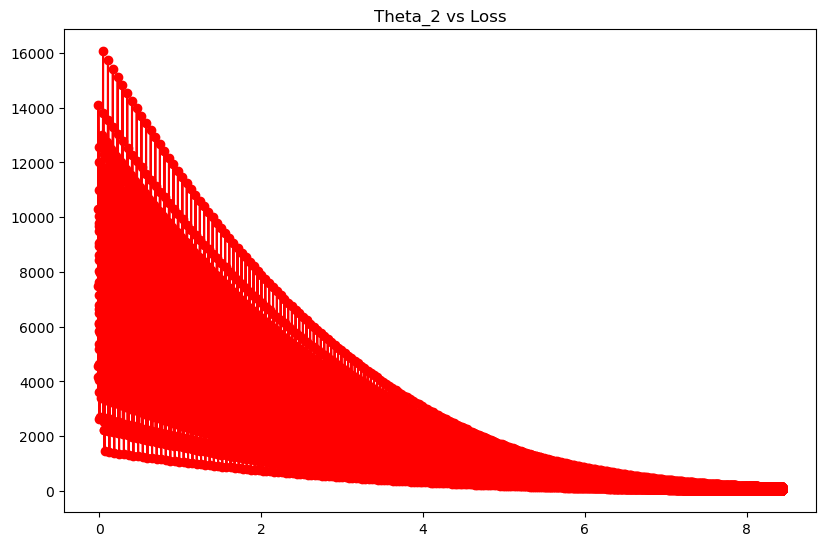

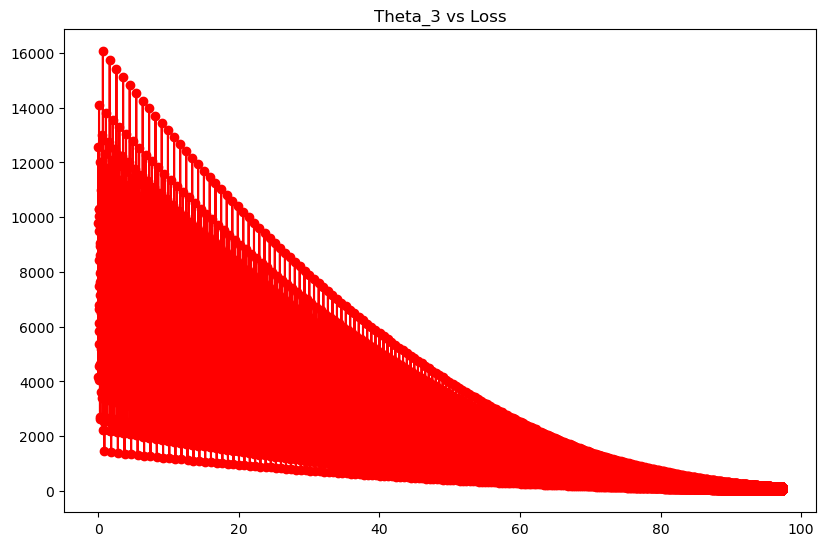

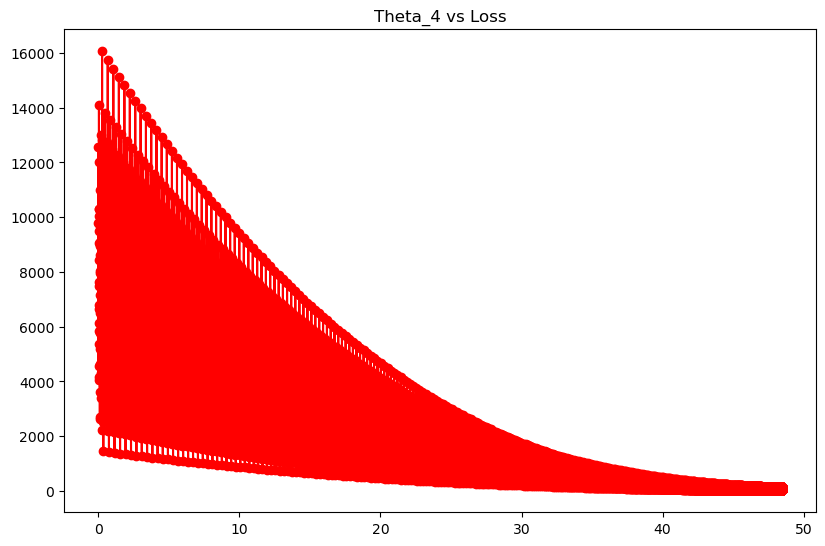

In [1061]:
GD2.plot_loss_thetas()            

#### Scenario 3: 
##### Gradient Descent with batch size = 83, No of Iters = 10000, learning rate = 0.0002, Cost Convergence Check and Cost Convergence Check = 0.00001

In [1098]:
GD3 = Optimizer(0.0002,10000,0.00001,0.00001,len(X_s)//12,'GD')

In [1099]:
GD3.train(X,y)

*************************** Epoch 1 ************************
Gradient Vector: 
 [[ -4.45172269  30.6785464   -5.50238071 -34.84058069 -20.19153151]]
Vector Norm: 51.11586098879324 

Theta: 
 [[0.01097681 0.25052222 0.03145001 0.48441041 0.20174017]]
j = 1367.9300333783342 

*************************** Epoch 2 ************************
Gradient Vector: 
 [[ -4.42624445  30.59324069  -5.49533448 -34.74855388 -20.1412531 ]]
Vector Norm: 50.97910150218066 

Theta: 
 [[0.0164192  0.37532664 0.04713771 0.72570568 0.30229867]]
j = 1361.2180422894116 

*************************** Epoch 3 ************************
Gradient Vector: 
 [[ -4.40083528  30.50815814  -5.48828536 -34.65676253 -20.0910923 ]]
Vector Norm: 50.84269386345818 

Theta: 
 [[0.02183108 0.49982759 0.06280057 0.96639635 0.40265002]]
j = 1354.539050316037 

*************************** Epoch 4 ************************
Gradient Vector: 
 [[ -4.37549497  30.42329817  -5.48123342 -34.56520602 -20.04104884]]
Vector Norm: 50.70663717475

In [1100]:
GD3.get_theta_opt()

array([[-0.60666149, 50.75821265,  8.15306747, 95.51716473, 46.9134836 ]])

In [1103]:
GD3.get_accuracy()

0.992782059886997

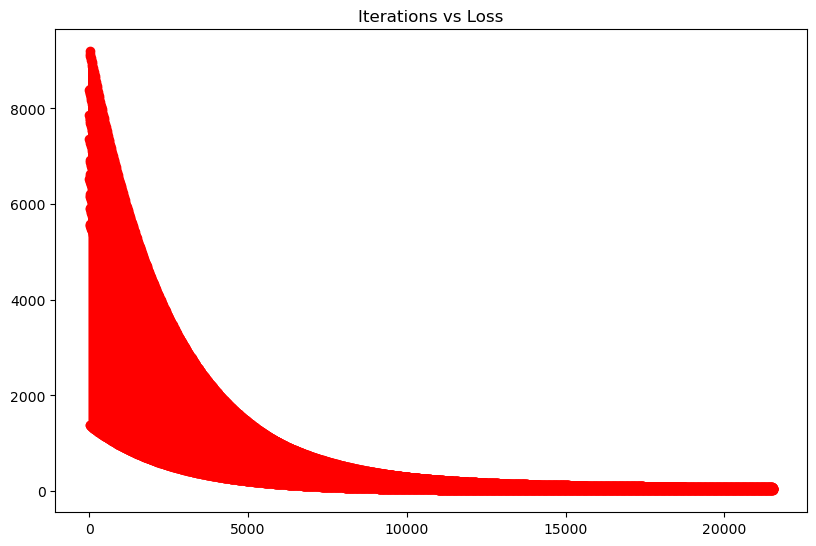

In [1104]:
GD3.plot_loss_iters()

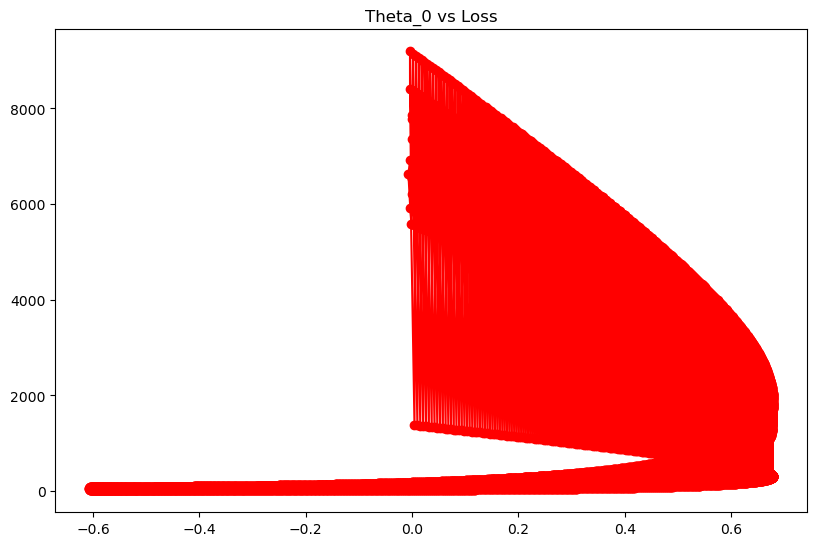

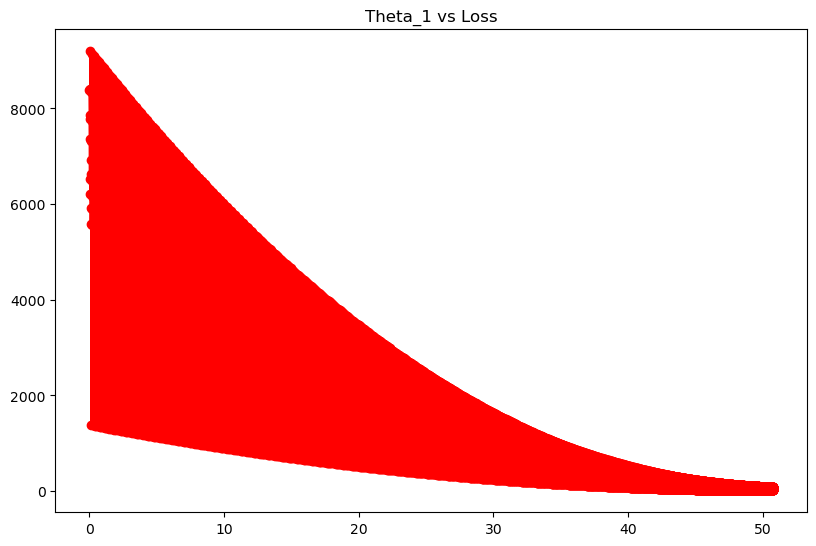

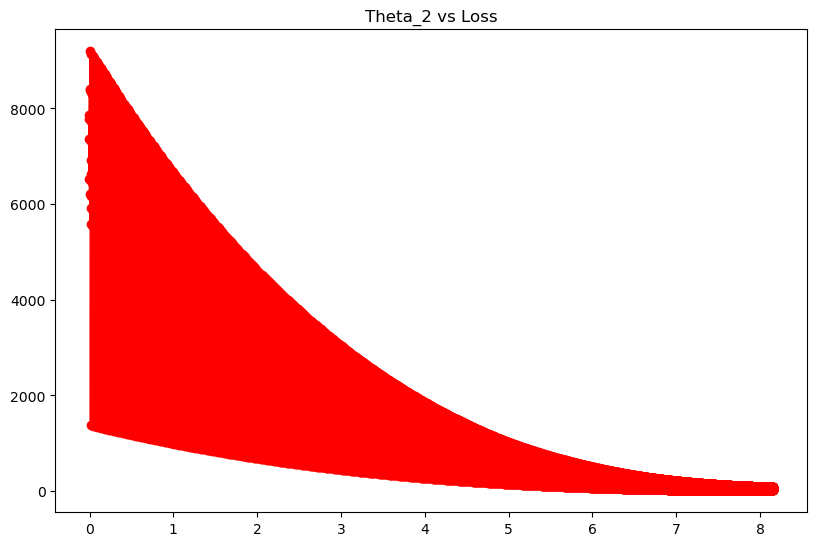

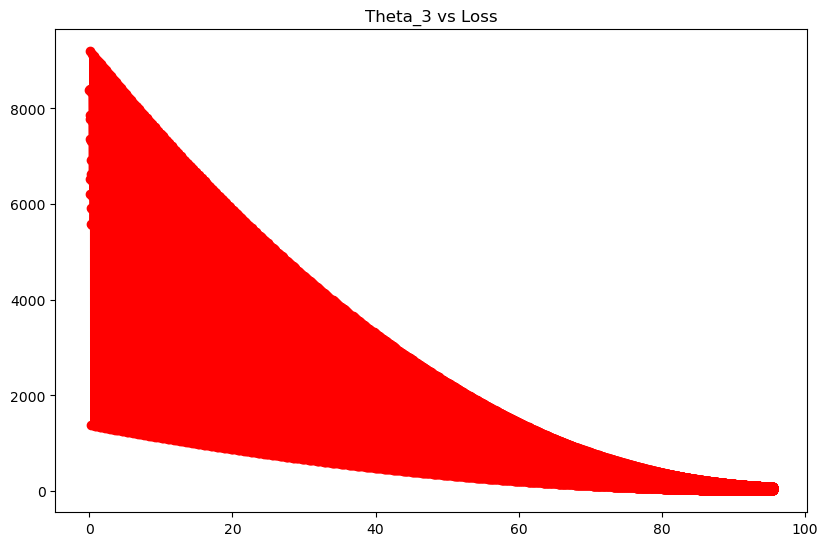

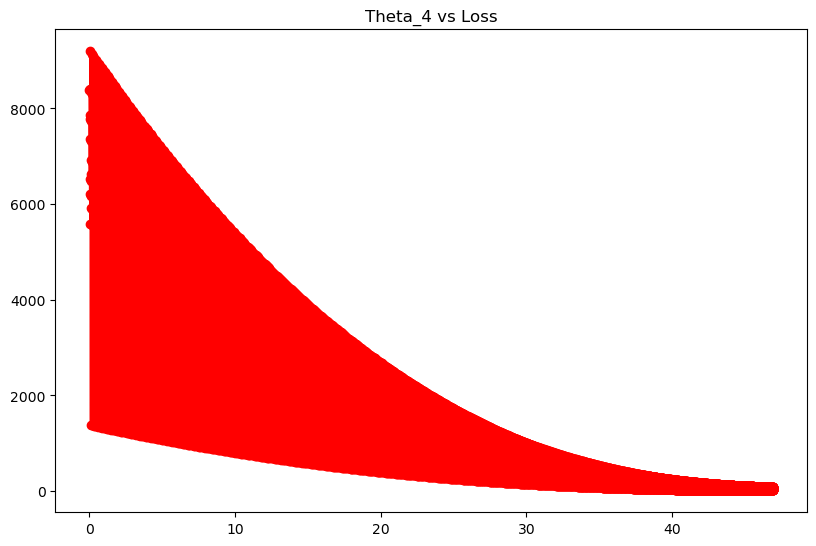

In [1105]:
GD3.plot_loss_thetas()            

#### Scenario 4: 
##### Batch Momentum Gradient Descent with batch size =1000, No of Iters = 2000, learning rate = 0.0005, Cost Convergence Check and Cost Convergence Check = 0.0001, Gamma= 0.9

In [1132]:
M1 = Optimizer(0.0005,2000,0.0001,0.0001,len(X),'Momentum',0.9)

In [1133]:
M1.train(X,y)

*********************** Iteration 1 ******************
h(x):[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Error Vector: 
 [[-3.45169018e+01 -5.99482777e+01  2.59202504e+00  1.25022755e+01
  -5.29509314e+01  8.81436039e+01 -3.15027981e+00 -3.41224248e+01
   3.64533511e+00 -1.22527395e+01 -2.23728992e+01  1.09434205e+02
   2.85487458e+01 -9.23884473e+01  2.99530673e+01  2.02155570e+01
  -1.37942266e+01  6.12353728e+00  3.99407152e+01  4.27763969e+01
   1.93502481e+00 -9.58203214e+00  5.59026412e+01 -5.25370135e+01
   3.38413732e-01 -3.71512570e+00  1.42483967e+01  5.15610833e+01
  -2.86132365e+01 -2.47790346e+01  1.98183006e+01  7.82981495e+01
   4.61544961e+01 -5.66671585e+01  1.77209101e+01 -2.44923130e+01
  -2.50302527e+01  1.44327701e+01  9.85951126e+00 -2.29102319e+01
   2.06778933e+01 -1.42816151e+01  2.90050919e+01  1.69020768e+01
   1.07538766e+02 -1.51184469e+01  5.06219158e+01 -1.87974608e+01
  -6.50444441e+01 -1.11213685e+01 -4.06898977e+00 -6.30801487e+01
  -5.94911093e+01  4.68417816e+01 -6.72973074e+01 -2.31587403e+01
  -9.38388308e+00  4.39215874e+01 -3.74970045e+01 -3.3241023

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Error Vector: 
 [[-1.53995707e+01 -2.60127240e+01 -3.93107292e+00  1.72422090e+01
  -2.42660228e+00  1.97782409e+01 -1.20096186e+01 -1.62540779e+01
   4.94026894e+00 -7.88945729e+00 -1.02220408e+01  4.72837300e+01
   7.96579851e+00 -3.83737016e+01  9.27428005e+00  4.91572488e-01
   3.51976898e+00  1.37722280e+00  1.44130870e+01  3.95988495e+00
  -6.69365705e-01 -1.09233769e+01  2.70760516e+01 -3.22004197e+01
  -3.08784561e+00 -2.64864778e+00  4.33558429e+00  2.49469247e+01
  -4.74341600e+00 -2.65887139e+00  2.93973936e+00  3.37248738e+01
   1.21518363e+01 -2.07960377e+01  6.83264200e+00 -5.97605157e+00
   4.91559532e-01  8.83047781e+00  5.54279043e+00 -1.07422047e+01
   7.38642302e+00 -8.51907831e-01  5.91887631e+00  1.46043902e+01
   3.61485237e+01 -5.93735578e+00  2.86573799e+01  5.32379195e-01
  -1.97200508e+01 -1.58577099e+01  8.53600311e+00 -2.49533062e+01
  -2.45274548e+01  1.11531535e+01 -2.90895502e+01 -1.54999977e+01
  -9.76664160e-01  2.43535617e+01 -3.83050129e+00 -4.4106639

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Error Vector: 
 [[-8.78239052e+00 -1.53648536e+01 -7.46108377e+00  1.86202310e+01
   1.32540422e+01 -2.68328217e+00 -1.32554132e+01 -9.68161612e+00
   5.78518985e+00 -5.42988505e+00 -6.81177096e+00  2.64901960e+01
   9.81515954e-01 -2.25392485e+01  2.77912959e+00 -5.88524501e+00
   8.54022685e+00 -2.13462476e+00  5.02439588e+00 -9.50271014e+00
  -2.32748183e+00 -1.26535403e+01  1.77773264e+01 -2.54900249e+01
  -4.66282376e+00 -1.50545632e+00  8.55656108e-01  1.60864006e+01
   1.62626658e+00  3.96941024e+00 -2.18652475e+00  1.92950617e+01
   1.08383714e+00 -1.03079050e+01  2.56860971e+00 -1.54702678e+00
   7.36554814e+00  6.64594150e+00  3.69055798e+00 -7.51424028e+00
   2.20214479e+00  3.44924184e+00 -1.76882265e+00  1.44339736e+01
   1.19425753e+01 -4.34855660e+00  2.24268131e+01  6.46826887e+00
  -5.07085707e+00 -1.74892659e+01  1.21268476e+01 -1.34671365e+01
  -1.36626995e+01 -4.31024666e-02 -1.78756512e+01 -1.20028585e+01
   1.18991903e+00  1.93895658e+01  5.71872961e+00  4.2641411

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



h(x):[[ 8.52796210e+01  1.62091032e+02 -1.84419087e+01  2.34732181e+01
   2.42902719e+02 -3.18695658e+02 -5.61189570e+01  7.70719824e+01
   2.15346412e+00  1.11795263e+01  6.14324391e+01 -2.85896801e+02
  -9.41122630e+01  2.68151609e+02 -9.87645497e+01 -9.29280268e+01
   8.57443689e+01 -4.77862999e+00 -1.10065522e+02 -1.74201131e+02
  -5.44136381e+00  5.10781113e+00 -1.36095134e+02  9.39855588e+01
  -1.21781438e+01 -3.02243687e+00 -4.41159528e+01 -1.22787690e+02
   1.23599716e+02  1.08064318e+02 -8.27171880e+01 -2.09198871e+02
  -1.58828870e+02  1.78083177e+02 -4.45704539e+01  1.00284061e+02
   1.31819327e+02 -2.31448659e+01 -1.64901455e+01  6.29890699e+01
  -5.47501280e+01  6.31159456e+01 -1.06661822e+02 -1.58513514e+01
  -3.25590156e+02  5.51350549e+01 -1.10929904e+02  9.34296508e+01
   2.12426799e+02 -2.13530579e+01  6.34445245e+01  1.86072021e+02
   1.68319075e+02 -1.70770630e+02  1.89190577e+02  2.70432718e+01
   4.39749310e+01 -1.03766251e+02  1.69988299e+02  1.41457880e+02
   3.

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



Gradient Vector: 
 [[ 0.04190177]
 [-0.09787214]
 [-0.0500384 ]
 [-0.24635968]
 [-0.24825078]]
Vector Norm: 0.3689987750851113 

theta_new : [[-0.4537469  51.43827953  8.3771954  96.98013014 48.15975494]] 

*********************** Iteration 1 ******************
h(x):[[ 8.60042727e+01  1.63098474e+02 -1.90531802e+01  2.35804773e+01
   2.44357106e+02 -3.21030239e+02 -5.59652814e+01  7.78754908e+01
   2.30912678e+00  1.16101071e+01  6.16771580e+01 -2.88108861e+02
  -9.48796558e+01  2.69455793e+02 -9.93819270e+01 -9.35735892e+01
   8.61299577e+01 -5.47605659e+00 -1.11210786e+02 -1.75709850e+02
  -5.76117798e+00  4.70737629e+00 -1.37037452e+02  9.46752401e+01
  -1.24230458e+01 -2.79173292e+00 -4.45126252e+01 -1.23722254e+02
   1.23992232e+02  1.08625939e+02 -8.31844089e+01 -2.10649706e+02
  -1.59946530e+02  1.78935859e+02 -4.51284416e+01  1.00443969e+02
   1.32262725e+02 -2.34325615e+01 -1.67623438e+01  6.31788781e+01
  -5.54303894e+01  6.35322574e+01 -1.07477390e+02 -1.57673703e+01
  -3.28

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [1135]:
M1.get_theta_opt()

array([[-0.48363185, 51.5009801 ,  8.41111703, 97.14140115, 48.32908862]])

In [1136]:
M1.get_accuracy()

0.9931731564969961

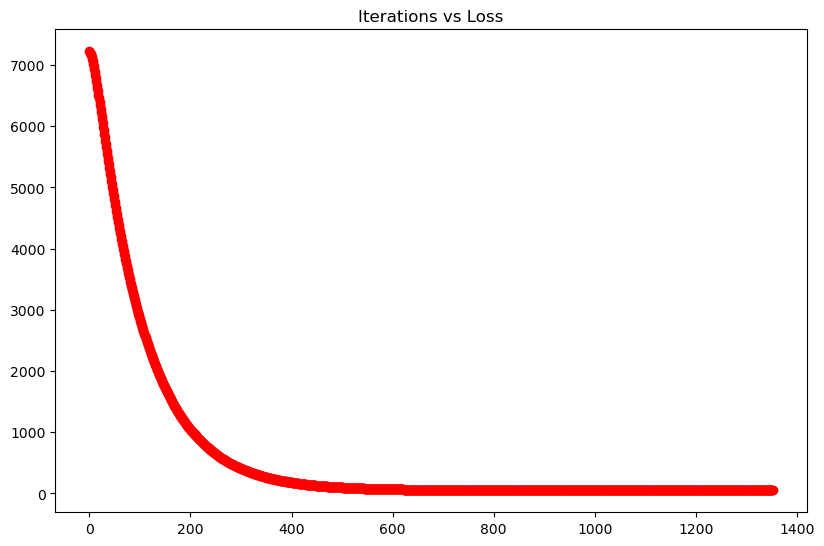

In [1137]:
M1.plot_loss_iters()

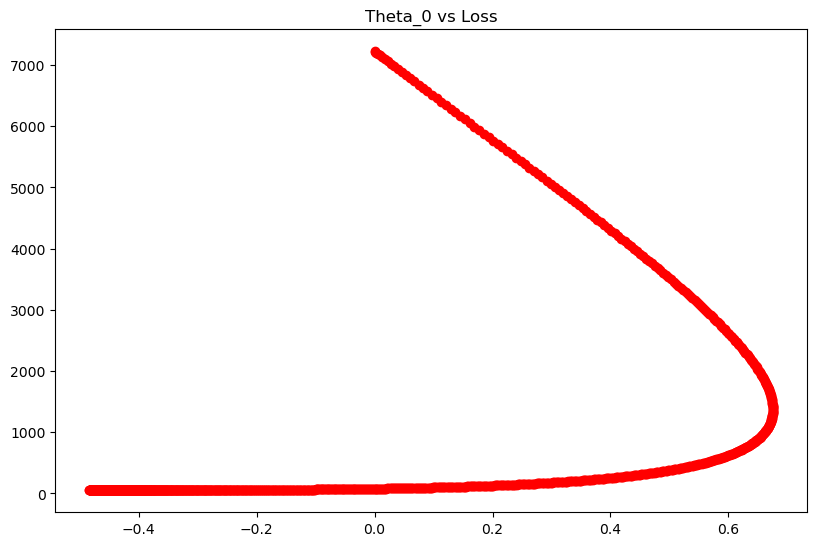

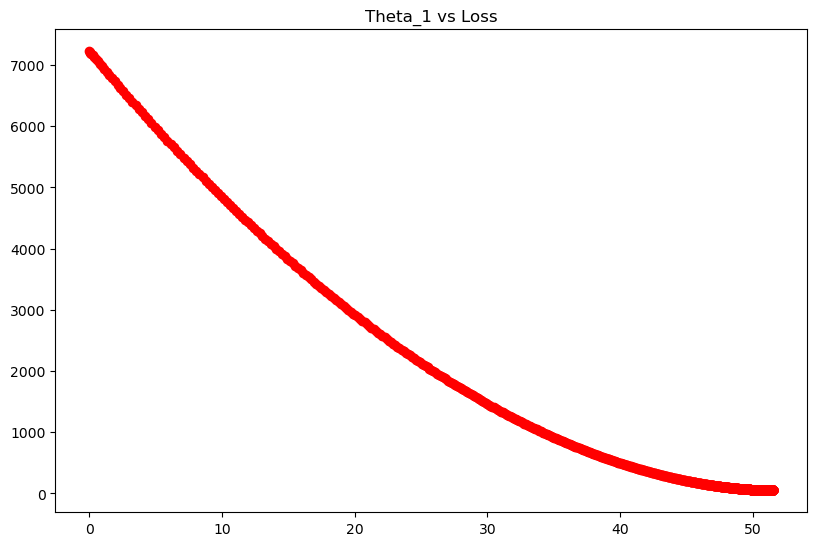

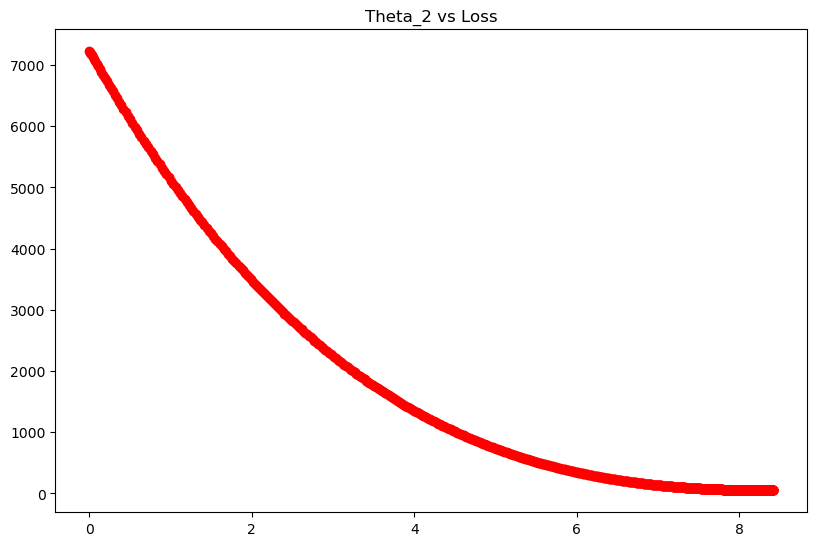

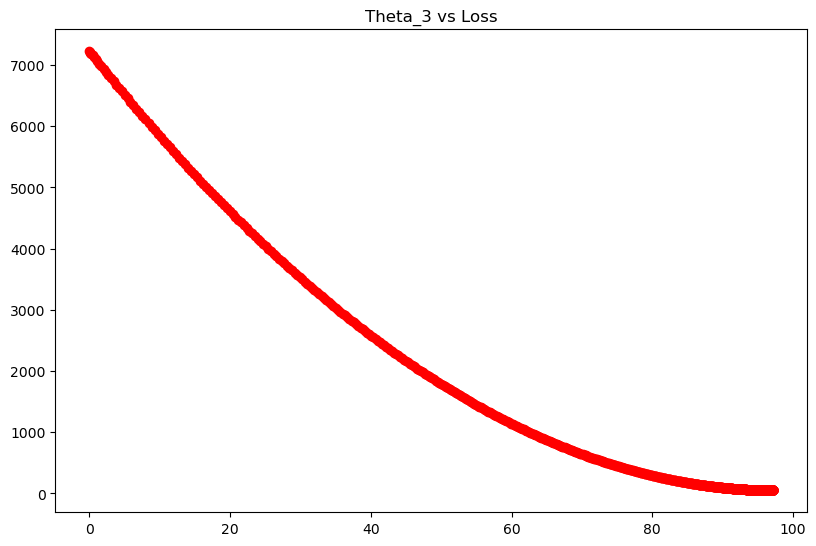

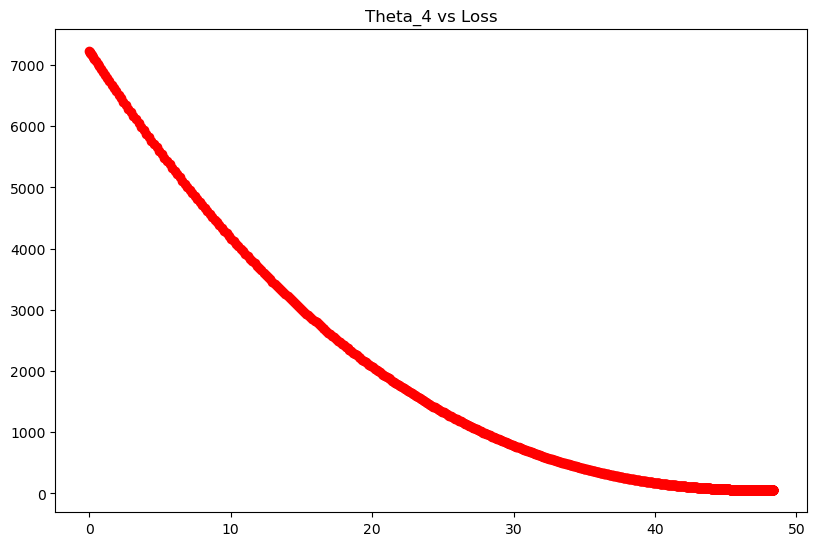

In [1138]:
M1.plot_loss_thetas()

#### Scenario 5: 
##### Momentum Gradient Descent with batch size 20, No of Iters = 1000, learning rate = 0.0005, Cost Convergence Check and Cost Convergence Check = 0.0001, Gamma= 0.5

In [1146]:
M2 = Optimizer(0.0005,1000,0.0001,0.0001,20,'Momentum',0.9)

In [1147]:
M2.train(X,y)

*********************** Iteration 1 ******************
h(x):[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]] 

Error Vector: 
 [[ -92.21648172 -174.72123091    9.6840955    -4.53036964 -225.66402792
   309.9581764    42.93218606  -84.81072024    3.95794288  -15.69706978
   -67.47648802  306.70374568   93.15387369 -286.90318832   99.87231473
    85.34852439  -76.03500484    1.22272984  112.31681982  160.90812419]]
j = 11165.040495637644
Gradient Vector: 
 [[   9.90019759]
 [ -62.08076281]
 [  63.33500766]
 [-145.23150982]
 [-113.5960445 ]]
Vector Norm: 204.84045251616055 

*********************** Iteration 2 ******************
h(x):[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]] 

Error Vector: 
 [[   2.46144959  -18.54253061  151.40315819 -117.67237525    6.97699145
     1.99552349   43.98224781  136.46348527 -120.63275955 -102.48148904
    79.24486619  224.66869726  156.96914523 -185.8954808    45.82483718
  -101.05748784 -122.981824     29.11636974   19

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [1148]:
M2.get_theta_opt()

array([[ 0.73735301, 51.72243688,  7.71690328, 95.60571328, 46.80852172]])

In [1149]:
M2.get_accuracy()

0.9926991313344027

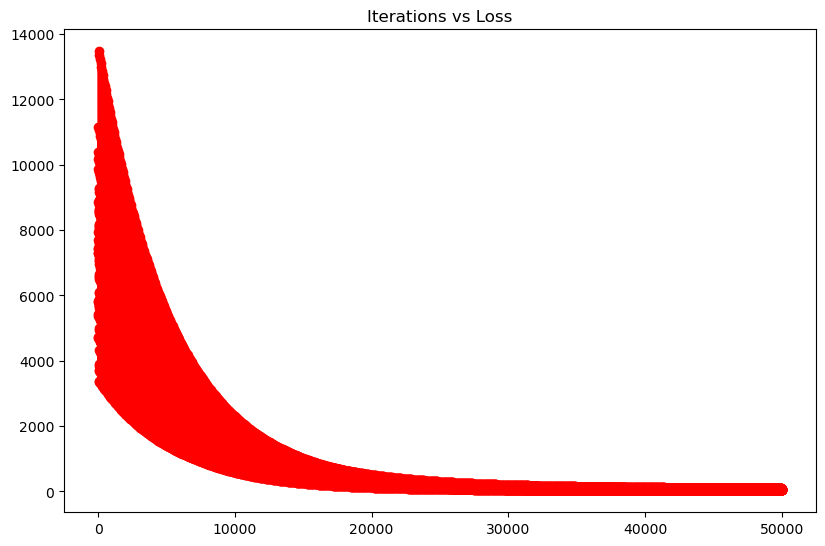

In [1150]:
M2.plot_loss_iters()

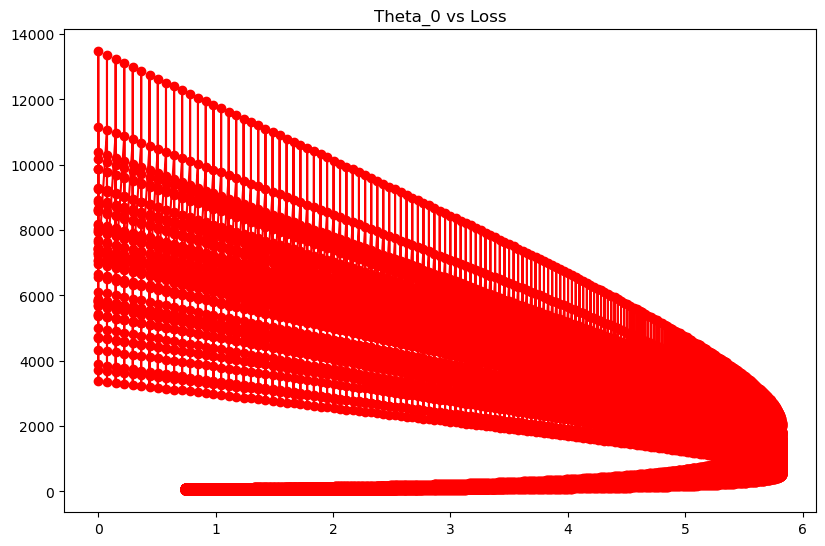

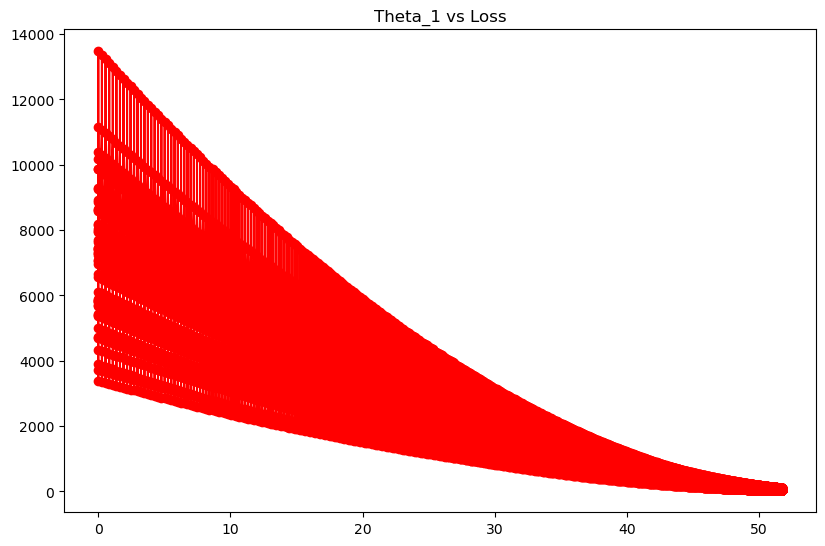

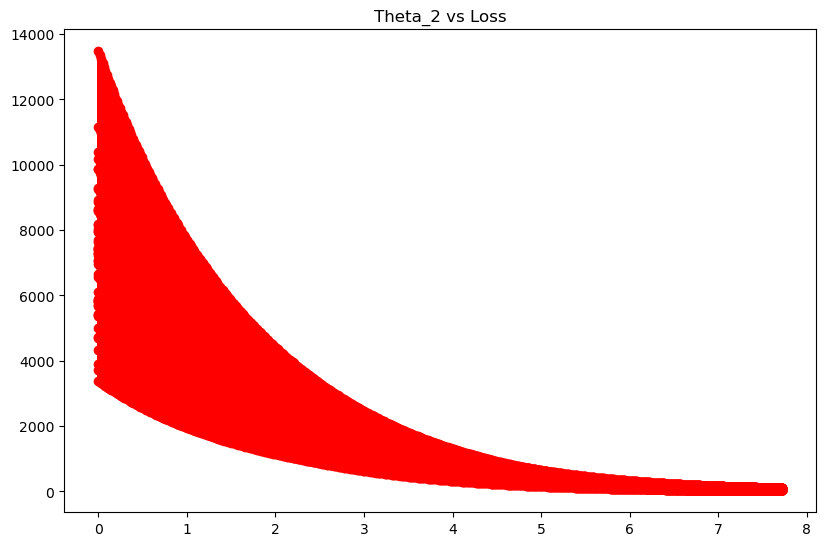

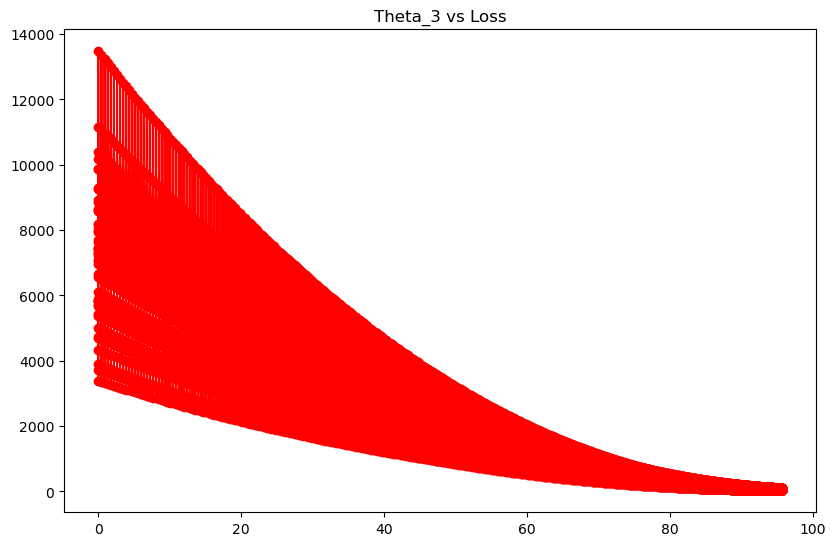

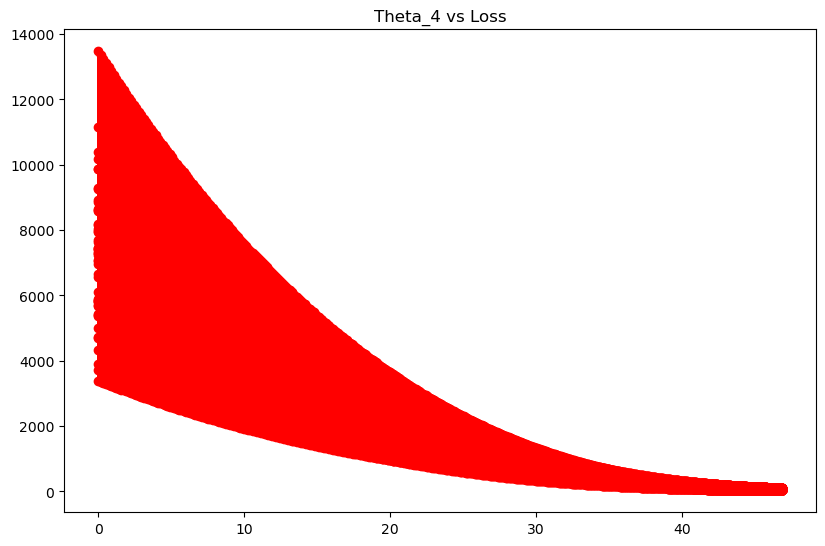

In [1151]:
M2.plot_loss_thetas()            

### Second Order Optimization (BFGS)

In [1039]:
class BFGS:
    def __init__(self,epsilon, max_iters, alpha):
        self.epsilon = epsilon
        self.max_iters = max_iters
        self.alpha = alpha
        self.loss = []
        self.thetas = []
        self.predictions = []
        

    def train(self, X, y):
        # Define symbols for variables
        epsilon=self.epsilon
        max_iters=self.max_iters 
        alpha=self.alpha
        n, m = X.shape
        self.y = y
    
        # Initialize variables
        curr_x = np.random.randn(1, X.shape[-1])+1   # Initialize with small random values
        prev_x = np.random.randn(1, X.shape[-1])
        B = np.eye(m)
        loss = []
        
        for i in range(1, max_iters + 1):
            
            # Calculate the current gradient
            y_predict_curr = np.matmul(X,curr_x.T)
            error_curr = (y_predict_curr-y)
            MSE_curr = (error_curr**2).mean()/2
            d_theta_curr = ((y_predict_curr - y)*X).mean(axis=0, keepdims=True)
            
            # Calculate the previous gradient
            y_predict_prev = np.matmul(X,prev_x.T)
            error_prev = (y_predict_prev-y)
            MSE_prev = (error_prev**2).mean()/2
            d_theta_prev = ((y_predict_prev - y)*X).mean(axis=0, keepdims=True)
    
            # Calculate delta_g and delta_x
            delta_g = d_theta_curr - d_theta_prev
            delta_x = curr_x - prev_x
    
            B = np.matmul(np.matmul((np.eye(m) - np.matmul(delta_x.T, delta_g) / np.matmul(delta_g, delta_x.T)), B),
                          (np.eye(m) - np.matmul(delta_g.T, delta_x) / np.matmul(delta_g, delta_x.T))) + \
                np.matmul(delta_x.T, delta_x) / np.matmul(delta_g, delta_x.T)
    
    
            x_new = curr_x - alpha * np.matmul(d_theta_curr,B)
            print(x_new)
            # Calculate the current MSE
            mse = np.mean(((np.matmul(X, curr_x.T) - y) ** 2) / 2)
            self.loss.append(mse)
            self.thetas.append(curr_x)
            
            if np.linalg.norm(d_theta_curr) < epsilon:
                print("No. of Iterations: {}".format(i))
                print('Optimum Thetas are \n {} '.format(curr_x))
                print('Gradient is \n {}'.format(d_theta_curr))
                print('MSE: {}'.format(mse))
                break
    
            prev_x = curr_x.copy()
            curr_x = x_new.copy()
        self.predictions = y_predict_curr


    def plot_loss_iters(self):
        plt.plot(range(0,len(self.loss)),self.loss,marker='o',color='red')
        plt.title('Iterations vs Loss')
        
    def plot_loss_thetas(self):
        theta_plot = np.concatenate(self.thetas, axis=0)
        for i in range(theta_plot.shape[1]):
            plt.figure()
            plt.plot(theta_plot[:,i],self.loss,marker='o',color='red')
            plt.title('Theta_{} vs Loss'.format(i));
            plt.show

    
    def get_accuracy(self):
        return r2_score(self.y,self.predictions)

    def get_theta_opt(self):
        return self.theta_opt

    def get_predictions(self):
        return self.predictions

    def get_loss(self):
        return self.loss

    def get_thetas(self):
        return self.thetas


In [1044]:
SecondOd = BFGS(0.0001,400,1)

In [1045]:
SecondOd.train(np.hstack((np.ones((len(X),1)),X)), y)

[[ 2.82265229 53.14060838  9.91717995 99.51091886 42.07245567]]
[[-0.33529329 51.40739638  8.50770804 97.40254011 48.11240804]]
[[-0.50251559 51.53173452  8.43070197 97.23032639 48.4399746 ]]
[[-0.50617839 51.53298295  8.43232759 97.23101735 48.43919315]]
[[-0.50618887 51.53304523  8.43236721 97.2309944  48.43916195]]
No. of Iterations: 5
Optimum Thetas are 
 [[-0.50617839 51.53298295  8.43232759 97.23101735 48.43919315]] 
Gradient is 
 [[ 8.43497568e-06 -6.27123805e-05 -4.11065881e-05  2.10441211e-05
   2.95106008e-05]]
MSE: 49.271810733167385


In [1047]:
SecondOd.get_loss()

[7134.890273589425,
 78.98496158014996,
 49.35931206785146,
 49.27182014944441,
 49.271810733167385]

In [1048]:
SecondOd.get_thetas()

[array([[ 1.57396696, -0.75357372,  3.08131466,  0.69544636,  1.09532081]]),
 array([[ 2.82265229, 53.14060838,  9.91717995, 99.51091886, 42.07245567]]),
 array([[-0.33529329, 51.40739638,  8.50770804, 97.40254011, 48.11240804]]),
 array([[-0.50251559, 51.53173452,  8.43070197, 97.23032639, 48.4399746 ]]),
 array([[-0.50617839, 51.53298295,  8.43232759, 97.23101735, 48.43919315]])]

In [1049]:
SecondOd.get_accuracy()

0.9931745717654401

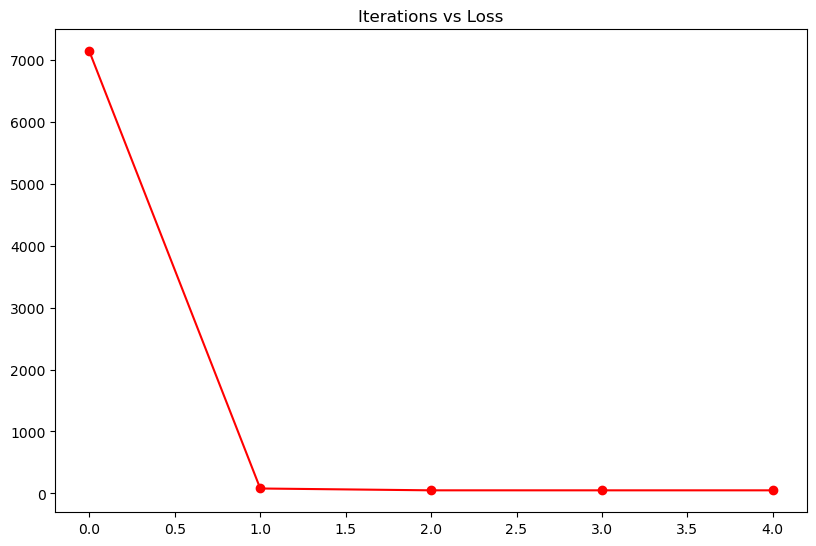

In [1050]:
SecondOd.plot_loss_iters()

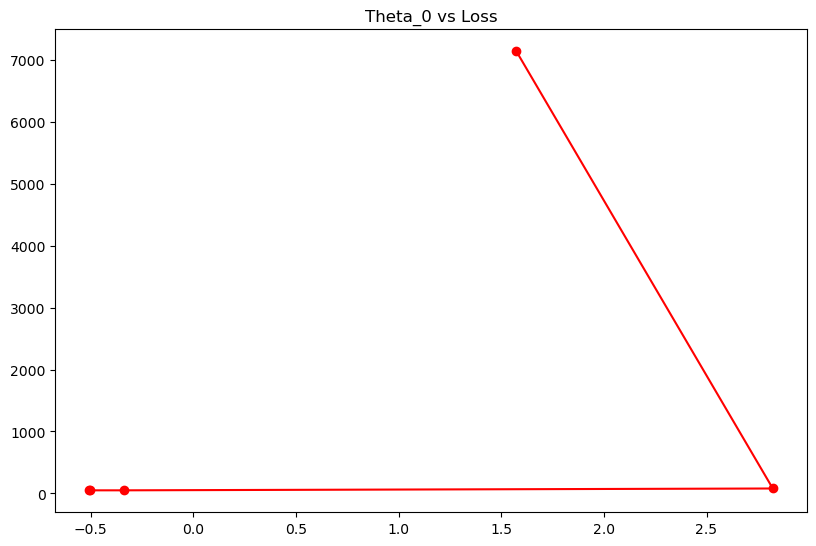

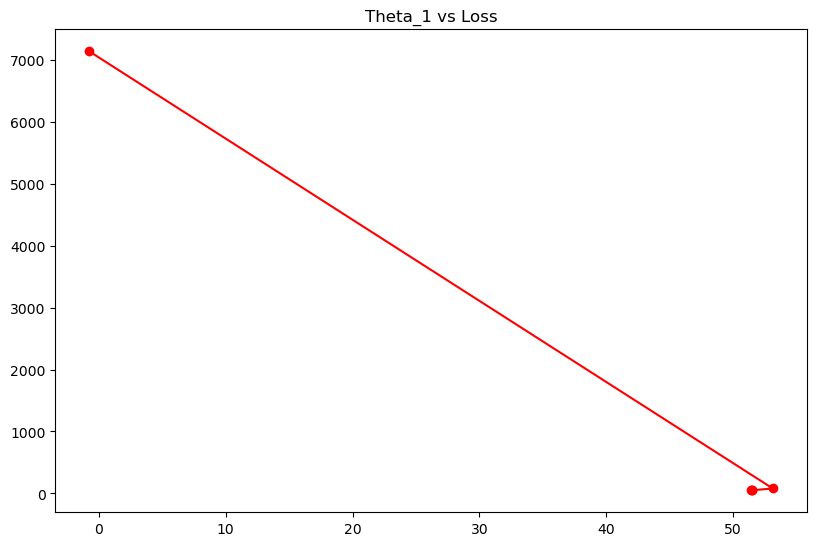

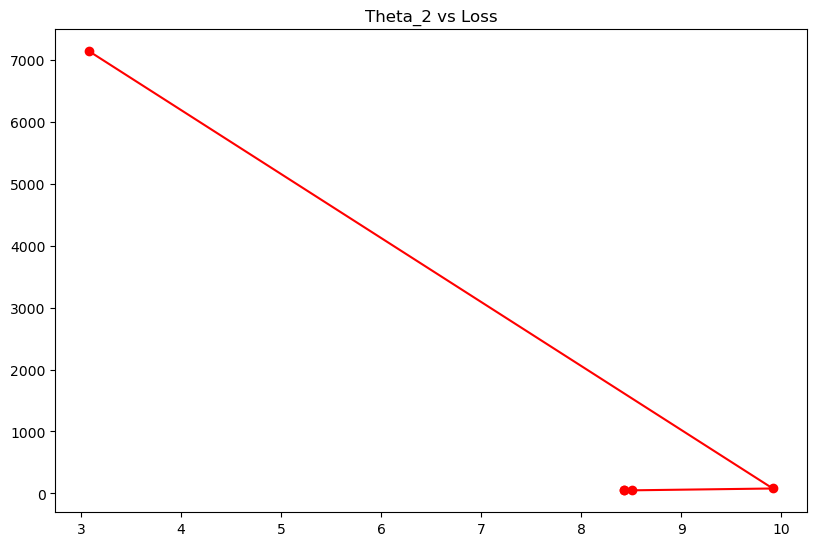

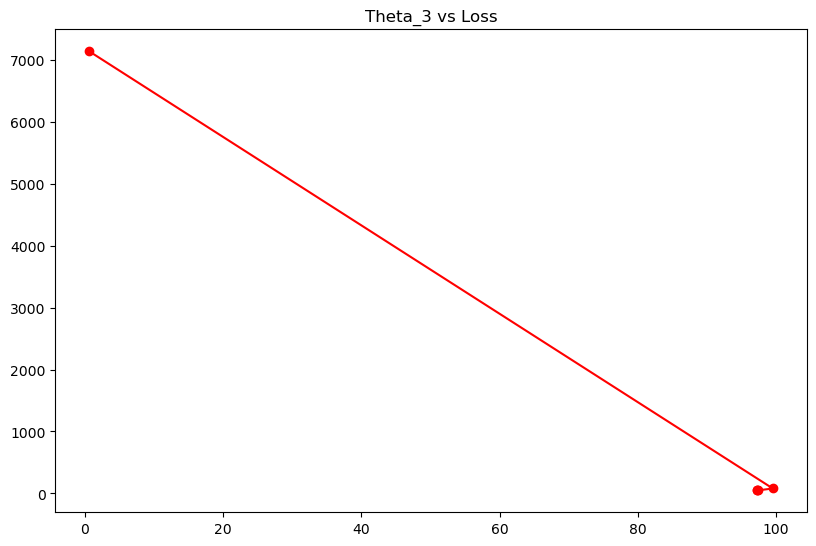

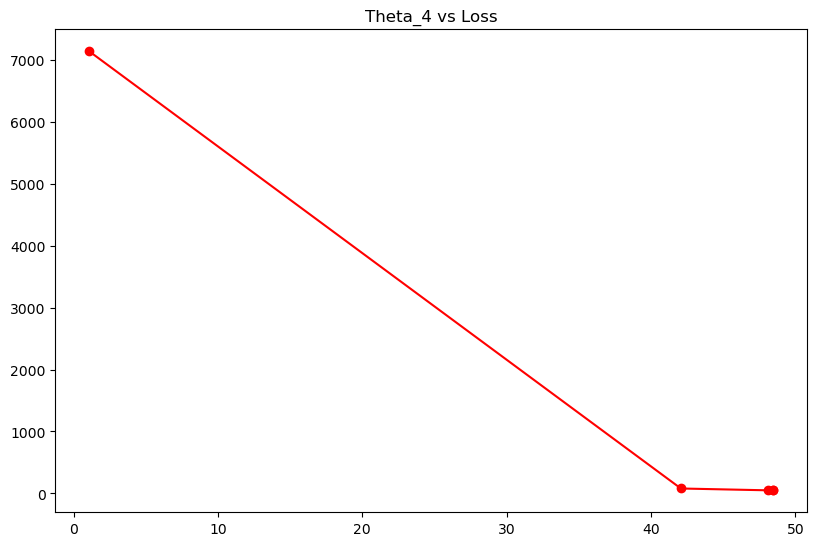

In [1051]:
SecondOd.plot_loss_thetas()